In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

pd.options.display.max_seq_items = 2000

# import python modules
%load_ext autoreload
%autoreload 2
import sys
sys.path.append('/Users/tabea/Documents/UrbanMobility/src')
from data import journey_data_aggregation as agg

# Data Aggregation and Analysis

### Hourly Data Aggregation

In [3]:
journey_17 = pd.read_csv('../data/processed/journey_data_2017.csv', parse_dates=['end_date', 'start_date'], index_col=0)
journey_18 = pd.read_csv('../data/processed/journey_data_2018.csv', parse_dates=['end_date', 'start_date'], index_col=0)
journey_19 = pd.read_csv('../data/processed/journey_data_2019.csv', parse_dates=['end_date', 'start_date'], index_col=0)

/Users/tabea/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/arraysetops.py:583: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [4]:
journey_17.head(2)

,rental_id,end_date,end_station_name,start_date,start_station_name,day_of_week,hour,is_weekend,part_of_day,month,...,election_seats_percentage_lab,election_seats_percentage_ld,election_seats_percentage_gre,election_seats_percentage_ind,occupation_high_level_ratio_ratio,occupation_small_intermediate_ratio_ratio,occupation_lower_level_ratio_ratio,occupation_unemployed_ratio_ratio,occupation_student_ratio_ratio,earnings_workplace
0,61395909.0,2017-01-01 00:49:00,"Pall Mall East, West End",2017-01-01 00:02:00,"Westbourne Grove, Bayswater",6,0,1.0,5,1.0,...,0.32,0.00,0.0,0.0,0.443089,0.161098,0.148262,0.118178,0.129374,60046.0
1,61395910.0,2017-01-01 00:43:00,"Harriet Street, Knightsbridge",2017-01-01 00:02:00,"Harriet Street, Knightsbridge",6,0,1.0,5,1.0,...,0.26,0.02,0.0,0.0,0.460353,0.177567,0.144639,0.104780,0.112661,41723.0


In [5]:
# hourly aggregation    
agg_journey_17 = agg.aggregate_demand_hourly(journey_17)
agg_journey_18 = agg.aggregate_demand_hourly(journey_18)
agg_journey_19 = agg.aggregate_demand_hourly(journey_19)


In [6]:
agg_journey_17.head(2)

,start_date_hour,start_borough,rental_id,end_date,end_station_name,start_date,start_station_name,day_of_week,hour,is_weekend,...,start_borough_Hackney,start_borough_Hammersmith and Fulham,start_borough_Islington,start_borough_Kensington and Chelsea,start_borough_Lambeth,start_borough_Newham,start_borough_Southwark,start_borough_Tower Hamlets,start_borough_Wandsworth,start_borough_Westminster
0,2017-01-01,Camden,61396232.0,2017-01-01 00:40:00,"Tavistock Place, Bloomsbury",2017-01-01 00:26:00,"Bayley Street , Bloomsbury",6,0,1.0,...,0,0,0,0,0,0,0,0,0,0
1,2017-01-01,City of London,61395930.0,2017-01-01 00:15:00,"Berry Street, Clerkenwell",2017-01-01 00:04:00,"King Edward Street, St Pauls",6,0,1.0,...,0,0,0,0,0,0,0,0,0,0


### Aggregated Demand Analysis: Yearly Comparisons

In [ ]:
boroughs = ['Westminster', 'Tower Hamlets', 'Kensington and Chelsea', 'Camden', 'Hammersmith and Fulham', 'Lambeth', 'Wandsworth', 'Southwark', 'Hackney', 'City of London', 'Islington', 'Newham'] 
for borough in boroughs:
    agg.plot_monthly_comparisons(agg_journey_17, agg_journey_18, agg_journey_19, borough)


/var/folders/7k/528cxkys5vv34d3vcx99jrwh0000gn/T/ipykernel_64081/393449889.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/7k/528cxkys5vv34d3vcx99jrwh0000gn/T/ipykernel_64081/393449889.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/7k/528cxkys5vv34d3vcx99jrwh0000gn/T/ipykernel_64081/393449889.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

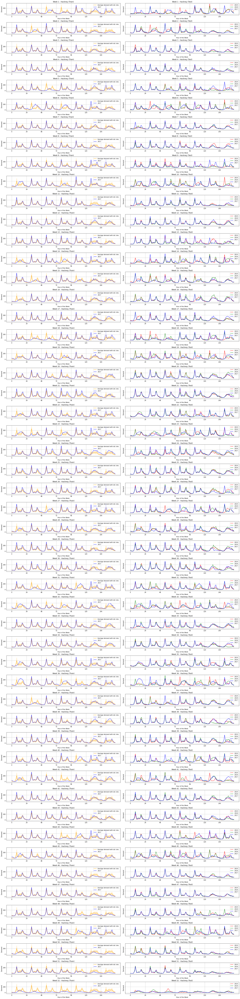

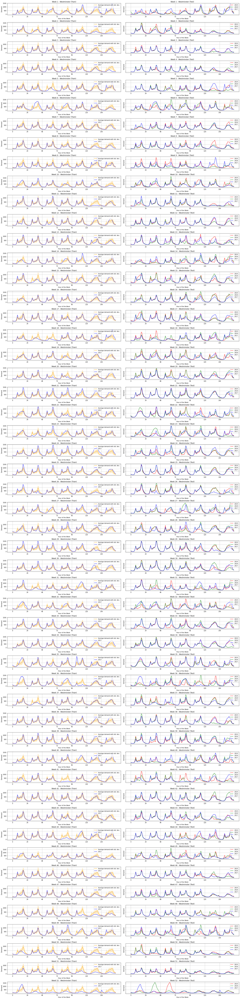

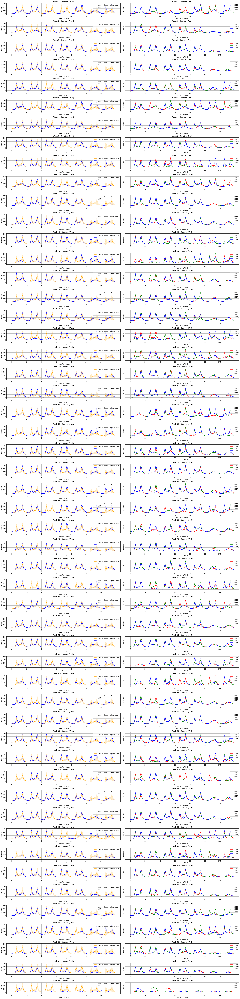

In [46]:
import matplotlib.pyplot as plt
import numpy as np

def plot_demand_by_week_borough(df_1, df_2, df_3, borough):
    # Filter out the data for the specified borough
    borough_data_1 = df_1[df_1[f'start_borough_{borough}'] == 1]
    borough_data_2 = df_2[df_2[f'start_borough_{borough}'] == 1]
    borough_data_3 = df_3[df_3[f'start_borough_{borough}'] == 1]
 
    # Add columns for the date, hour, and week for training data
    borough_data_1['date'] = borough_data_1['start_date_hour'].dt.date
    borough_data_1['week_of_year'] = borough_data_1['start_date_hour'].dt.isocalendar().week
    borough_data_1['hour_of_week'] = borough_data_1['day_of_week'] * 24 + borough_data_1['hour']

    borough_data_2['date'] = borough_data_2['start_date_hour'].dt.date
    borough_data_2['week_of_year'] = borough_data_2['start_date_hour'].dt.isocalendar().week
    borough_data_2['hour_of_week'] = borough_data_2['day_of_week'] * 24 + borough_data_2['hour']

    borough_data_3['date'] = borough_data_3['start_date_hour'].dt.date
    borough_data_3['week_of_year'] = borough_data_3['start_date_hour'].dt.isocalendar().week
    borough_data_3['hour_of_week'] = borough_data_3['day_of_week'] * 24 + borough_data_3['hour']


    # Aggregate by week and hour of the week for training data
    borough_1_weekly_hourly = borough_data_1.groupby(['week_of_year', 'hour_of_week']).agg({'demand': 'sum'}).reset_index()
    borough_2_weekly_hourly = borough_data_2.groupby(['week_of_year', 'hour_of_week']).agg({'demand': 'sum'}).reset_index()
    borough_3_weekly_hourly = borough_data_3.groupby(['week_of_year', 'hour_of_week']).agg({'demand': 'sum'}).reset_index()

    # Calculate the average and standard deviation over all weeks for df1
    mean_weekly_demand_data_1 = borough_1_weekly_hourly.groupby('hour_of_week')['demand'].mean()
    stand_weekly_demand_data_1 = borough_1_weekly_hourly.groupby('hour_of_week')['demand'].std()
    
    # Create subplots for each week
    fig, axs = plt.subplots(nrows=52, ncols=2, figsize=(24, 100), constrained_layout=True, sharey='row')

    # Plot each week's data for training and test data
    for idx, week in enumerate(borough_1_weekly_hourly['week_of_year'].unique()):
        
        # Calculate weekly demand
        week_data_1 = borough_1_weekly_hourly[borough_1_weekly_hourly['week_of_year'] == week]  
        week_data_2 = borough_2_weekly_hourly[borough_2_weekly_hourly['week_of_year'] == week]
        week_data_3 = borough_3_weekly_hourly[borough_3_weekly_hourly['week_of_year'] == week]

        # Plot the average and standard deviation from all weeks for training data
        axs[idx, 0].plot(mean_weekly_demand_data_1.index, mean_weekly_demand_data_1, color='orange', label='Average demand 2017 with std. dev.')
        axs[idx, 0].fill_between(stand_weekly_demand_data_1.index, (mean_weekly_demand_data_1 - stand_weekly_demand_data_1), (mean_weekly_demand_data_1 + stand_weekly_demand_data_1),
                               color='orange', alpha=.2)
        
        axs[idx, 0].plot(week_data_1['hour_of_week'], week_data_1['demand'], color='blue', label='2017')

        axs[idx, 0].set_title(f'Week {week} - {borough} (2017)')
        axs[idx, 0].set_xlabel('Hour of the Week')
        axs[idx, 0].set_ylabel('Demand')
        axs[idx, 0].set_xticks(np.arange(0, 168, 24))  # Set x-axis ticks every 24 hours
        axs[idx, 0].legend(loc="upper right")
        axs[idx, 0].grid(True)

        # Plot test data for the corresponding week
        axs[idx, 1].plot(week_data_3['hour_of_week'], week_data_3['demand'], color='red', label='2019')       
        axs[idx, 1].plot(week_data_2['hour_of_week'], week_data_2['demand'], color='green', label='2018')
        axs[idx, 1].plot(week_data_1['hour_of_week'], week_data_1['demand'], color='blue', label='2017')
    

        axs[idx, 1].set_title(f'Week {week} - {borough} (year comparison)')
        axs[idx, 1].set_xlabel('Hour of the Week')
        axs[idx, 1].set_ylabel('Demand')
        axs[idx, 1].set_xticks(np.arange(0, 168, 24))  # Set x-axis ticks every 24 hours
        axs[idx, 1].legend(loc="upper right")
        axs[idx, 1].grid(True)

    plt.show()

# Call the function for each borough
boroughs = ['Hackney', 'Westminster', 'Camden']  # Add more boroughs as needed
for borough in boroughs:
    plot_demand_by_week_borough(agg_journey_17, agg_journey_18, agg_journey_19, borough)


### Aggregated Demand Analysis: Variability of Weekdays

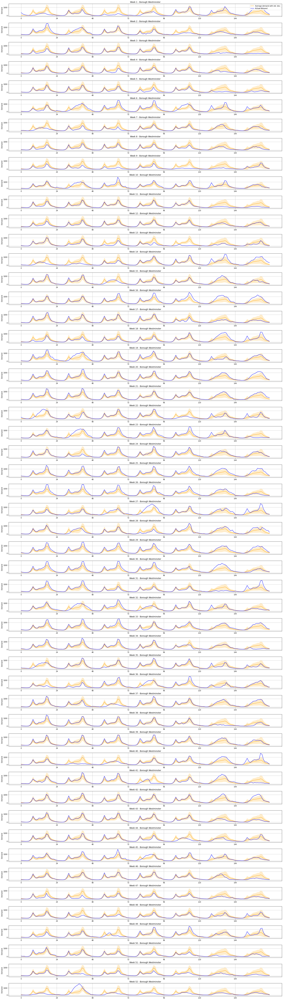

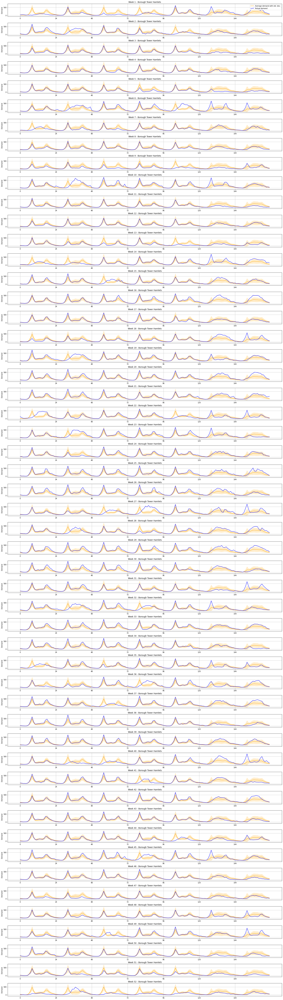

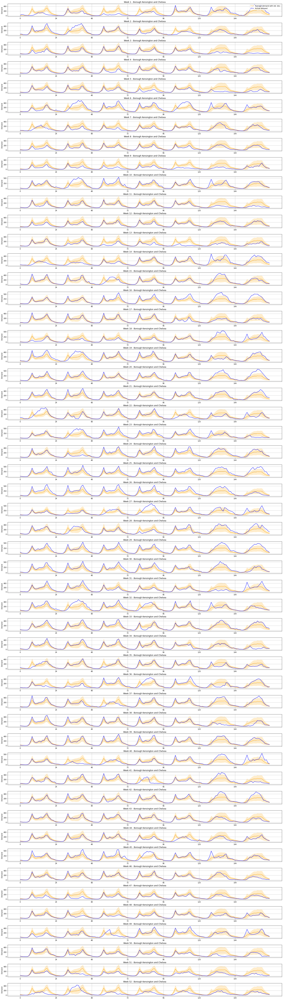

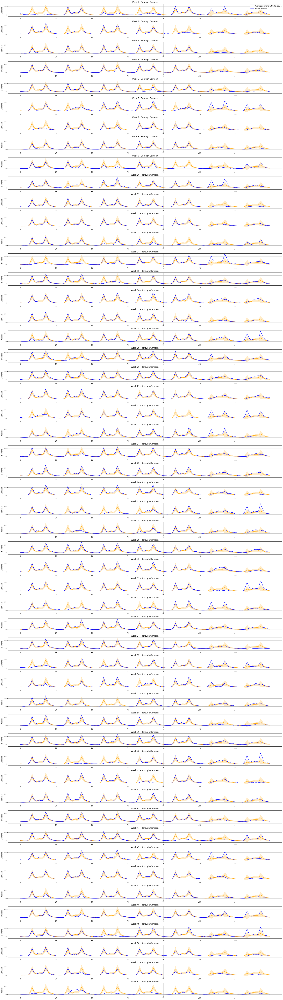

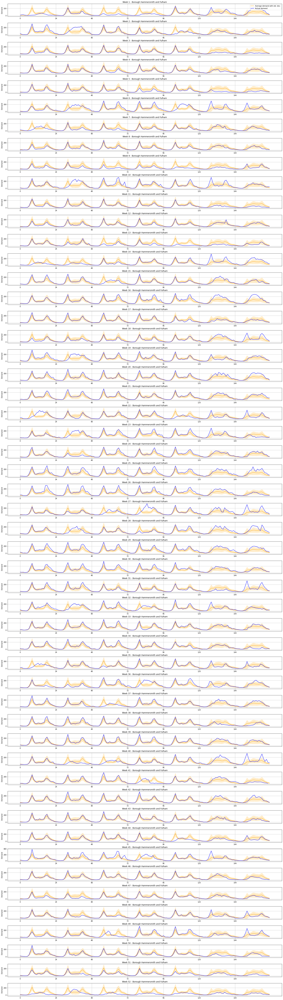

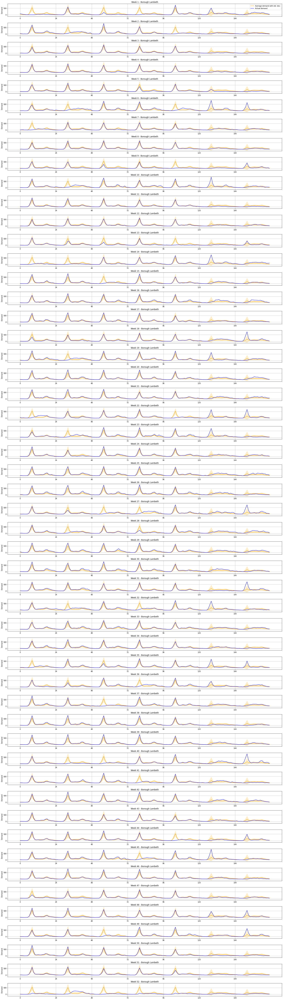

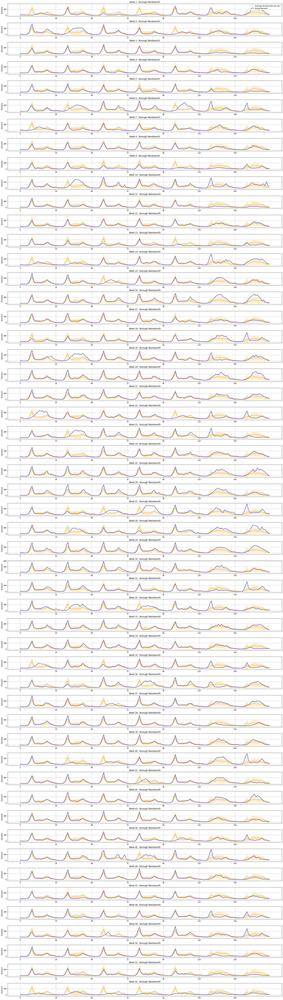

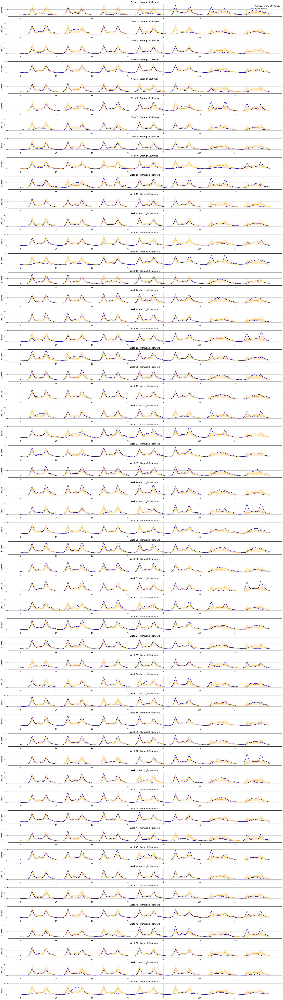

KeyboardInterrupt: 

In [34]:
boroughs = ['Westminster', 'Tower Hamlets', 'Kensington and Chelsea', 'Camden', 'Hammersmith and Fulham', 'Lambeth', 'Wandsworth', 'Southwark', 
            'Hackney', 'City of London', 'Islington', 'Newham']

# Call the function for each borough
for borough in boroughs:
    agg.plot_variability_weekdays(agg_journey_18, borough)
